
<h1>
MEJORANDO LA RESOLUCIÓN EN IMÁGENES SATELITALES MEDIANTE TÉCNICAS DE VISIÓN ARTIFICIAL Y MACHINE LEARNING
</h1>

<hr>

- Johan Sebastian Muñoz Ossa  -  js.munoz.ai@gmail.com

**¿Qué es la resolución en imágenes?**

La resolución de una imagen indica la cantidad de detalles que puede observarse en esta. El término es comúnmente utilizado en relación a imágenes de fotografía digital, pero también se utiliza para describir cuán nítida (como antónimo de granular) es una imagen de fotografía convencional (o fotografía química). Tener mayor resolución se traduce en obtener una imagen con más detalle o calidad visual.

**Superresolución en imágenes:**

Se conoce como superresolución al conjunto de técnicas y algoritmos diseñados para aumentar la resolución espacial de una imagen, normalmente a partir de una secuencia de imágenes de más baja resolución para lograr esto, una función matemática toma la imagen en baja resolución (con falta de detalles) y rellena esta información para así producir la imagen de mayor resolución.

**¿Por qué?**

Porque muchos procesos de adquisición de imágenes, los cuales son importantes para el desarrollo económico y tecnológico, suelen ser difíciles de llevar a cabo debido a las condiciones con las que se obtienen estas. Por lo tanto, entregan imágenes de calidades menores a las necesarias para ser usadas. 
Un claro ejemplo es el caso de estudio que se busca abordar, la adquisición de imágenes satelitales, donde las grandes distancias, la cantidad de ruido presente en la atmósfera y los difíciles procesos de transmisión de los datos, generan imágenes con calidades que pueden (y por lo general deben) ser mejoradas mediante algún método de visión artificial.

**¿Para qué?**

La superresolución juega un papel protagónico en la última década puesto que tiene diversas aplicaciones en gran variedad de industrias, para lograr obtener más información como por ejemplo:

Mejorar la calidad visual de videojuegos
Mejorar la calidad de películas e imágenes antiguas
Mejorar la calidad de imágenes médicas para tener un mejor diagnóstico de los pacientes (vasos sanguíneos, células, lunares de piel, etc.)
Mejorar la calidad de imágenes astronómicas para llevar a cabo estudios más detallados (Por ejemplo, reto de la NASA: super - resolución aplicada a la corona solar para mejorar la calidad de las imágenes).
Mejorar la calidad de las imágenes satelitales para diversos usos como por ejemplo planes de ordenamiento territorial, análisis de terreno para cultivo, minería, entre otros.



**¿Cómo?**

El objetivo de nuestro trabajo se basa en "únicamente" mejorar la resolución de las imágenes. Cabe anotar que el procedimiento a seguir es puramente heurístico y por ahora el interés no es profundizar teóricamente en el tema. Para esto se probarán las diversas técnicas propias de la disciplina de visión por computador desarrolladas en el curso, sin embargo, como se verá más adelante, para la solución de este problema solo se obtienen resultados satisfactorios con técnicas como interpolaciones, algoritmos de umbralización, ecualización del histograma, filtrado o convolución y algoritmos de agrupamiento.



In [3]:
# gráficas
%matplotlib inline
import matplotlib.pyplot as plt
import cv2

# manejo de archivos
import numpy as np
import os
import math

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


**Funciones a usar a lo largo de todo el notebook.**

In [4]:
# Leer la imagen en RGB o escala de grises 
def img_read(filename, mode = 'color'):

    if(mode == 'color'):   
        return cv2.cvtColor(cv2.imread(filename),cv2.COLOR_BGR2RGB)
    elif(mode=='grayscale' or mode=='greyscale' or mode == 'gray' or mode == 'grey'):
        return cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    else:
        return None


# Imagen en blanco y negro
def img_bn(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)


# Función para transformar de RGB a otro espacio de color
def color_space_convert(img, mode):
    if mode == "lab":
        return cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
    elif mode == "hsv":
        return cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    elif mode == "yuv":
        return cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    else:
        return "El espacio de color debe ser LAB o HSV o YUV"


# Función para obtener la imagen con su respectiva ecualización del histograma
def equalizedImage(image):

    a = np.asarray(image, dtype="f8")
    b = np.divide(a, 255)
    c = np.zeros_like(a, dtype="uint8")
    bn = cv2.equalizeHist(img_bn(image))

    for i in range(a.shape[0]):
        for j in range(a.shape[1]):
            c[i, j] = b[i, j]*bn[i, j]
    return c


# Función para aplicar la transformación sobre la imagen RGB
def apply_f_on_rgb(img, f, args):
    # matriz de ceros del tamaño de la imagen de entrada
    res = np.zeros(img.shape, np.uint8)
    # Aplicar la transformación f sobre cada canal del espacio de color RGB
    res[:,:,0] = f(img[:,:,0], *args)
    res[:,:,1] = f(img[:,:,1], *args)
    res[:,:,2] = f(img[:,:,2], *args)
    
    return res


# Función para graficar una imágen junto con su histograma y la distribución acumulada
def plot_img_and_hist(image, axes, bins=256):

    image = img_as_float(image)
    ax_img, ax_hist = axes
    ax_cdf = ax_hist.twinx()

    # mostrar la imagen
    ax_img.imshow(image, cmap="gray")
    ax_img.set_axis_off()

    # mostrar el histograma
    ax_hist.hist(image.ravel(), bins=bins, histtype='step', color='black')
    ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
    ax_hist.set_xlabel('Intensidad de pixeles')
    ax_hist.set_xlim(0, 1)
    ax_hist.set_yticks([])

    # mostrar la distribución acumulada
    img_cdf, bins = exposure.cumulative_distribution(image, bins)
    ax_cdf.plot(bins, img_cdf, 'r')
    ax_cdf.set_yticks([])

    return ax_img, ax_hist, ax_cdf


#Definir la función de transformación de la imagen (corrección gamma)
def gamma_correction(img, a, gamma):
    
    # Crear copia de la imagen tipo flotante dada la normalización
    img_copy = img.copy().astype(np.float32)/255.0

    # La función corrección gamma es de la forma ax^gamma, donde x es la imagen de entrada
    res_gamma = cv2.pow(img_copy,gamma)
    res = cv2.multiply(res_gamma, a)
    
    #Asegurar que la los datos queden entre 0 y 255 y sean uint8
    res[res<0] = 0
    res = res*255.0
    res[res>255] = 255
    
    res = res.astype(np.uint8)
    return res


# Se define la funciónm de expansión del histograma
def histogram_expansion(img):
    
    #Crear matriz de ceros del tamaño de la imagen y tipo de dato flotante
    res = np.zeros([img.shape[0], img.shape[1]], dtype=np.float32)
    
    #Extraer el mínimo y el máximo del conjunto de datos
    m = float(np.min(img))
    M = float(np.max(img))
    #Aplicar la función de expansión(normalización) y asegurar datos uint8
    res = (img-m)*255.0/(M-m)
    res = res.astype(np.uint8)
    
    return res

**Metricas de calidad de la imagen**

Definimos las 3 funciones para medir la calidad de la imágen cómo: PSNR, MSE, y SSIM.  El **ínidice de similitud estructural (SSIM)**  es importada directamente desde scikit-image; las funciones de métricas **relacion pico-señal-ruido (PSNR)** y la clásica métrica en estadística **error cuadrático medio (MSE)** serán construídas por nosotros siguiendo las indicaciones de la teoría.

- La métrica **MSE** mide la diferencia cuadrada promedio entre los valores de píxel reales e ideales. Esta métrica es fácil de calcular, pero podría no alinearse bien con la percepción humana de la calidad.

- La métrica **RMSE** realiza todo el mismo procedimiento de la métrica MSE y al final aplica una raíz cuadrada a este valor MSE. 

- La métrica **PSNR** se deriva del error cuadrado medio, e indica la relación de la intensidad máxima de píxeles a la potencia de la distorsión. Al igual que el MSE, la métrica PSNR es fácil de calcular pero puede no alinearse bien con la calidad percibida.

- La métrica **SSIM** combina la estructura de imagen local, la luminancia y el contraste en una única puntuación de calidad local. En esta métrica, son patrones de intensidades de píxeles, especialmente entre píxeles vecinos, después de normalizar la luminancia y el contraste.  Debido a que el sistema visual humano es bueno para percibir la estructura, la métrica de calidad SSIM está más de acuerdo con la puntuación de calidad subjetiva.

In [5]:
# función para calcular el índice de similitud estructural (Structural similarity index - SSIM)
from skimage.measure import compare_ssim as ssim

# función para calcular la relación pico señal ruido (peak signal to noise ratio - PSNR)
def psnr(target, ref):
         
    # recibe imágen RGB
    target_data = target.astype(float)
    ref_data = ref.astype(float)

    # diferencia entre el valor real y el valor de la predicción/distorsión
    diff = ref_data - target_data
    diff = diff.flatten('C')

    # raiz del error cuadrático medio
    rmse = math.sqrt(np.mean(diff ** 2.))

    return 20 * math.log10(255. / rmse)


# función para calcular la raiz del error cuadrático medio (root mean squared error - RMSE)
def rmse(target, ref):
    # el MSE entre 2 imágenes es la sumatoria de cuadrados para la resta entre la prediccion y el valor real
    err = np.sum((target.astype('float') - ref.astype('float')) ** 2)
    err /= float(target.shape[0] * target.shape[1])
    
    return math.sqrt(err)

# función que combina las 3 métricas de calidad de la imágen 
def compare_images(target, ref):

    scores = []
    scores.append(psnr(target, ref))
    scores.append(rmse(target, ref))
    scores.append(ssim(target, ref, multichannel =True))
    
    return scores

<h1>
Lectura de Archivos
</h1>

<hr>

In [6]:
# Archivos
file_path = '/content/drive/MyDrive/Super-resolución V.A./DeepGlobe/'

#Lectura a color de las imágenes a usar en baja resolución
img1 = img_read(file_path+"images_LR/0.jpg" , mode="color")
img2 = img_read(file_path+"images_LR/1.jpg" , mode="color")
img3 = img_read(file_path+"images_LR/2.jpg" , mode="color")
img4 = img_read(file_path+"images_LR/3.jpg" , mode="color")
img5 = img_read(file_path+"images_LR/4.jpg" , mode="color")

#Lectura a color de las imágenes a usar en alta resolución
img1_hd = img_read(file_path+"images_HR/0.jpg" , mode="color")
img2_hd = img_read(file_path+"images_HR/1.jpg" , mode="color")
img3_hd = img_read(file_path+"images_HR/2.jpg" , mode="color")
img4_hd = img_read(file_path+"images_HR/3.jpg" , mode="color")
img5_hd = img_read(file_path+"images_HR/4.jpg" , mode="color")



<h1>
Visualización de algunos datos en diferentes espacios de color
</h1>

<hr>

- Imágenes originales
- Imágenes a blanco y negro 
- Imágenes en espacio de color LAB
- Imágenes en espacio de color HSV
- Imágenes en espacio de color YUV

(Text(0.5, 1.0, 'Imagen 5 YUV'),
 <matplotlib.image.AxesImage at 0x7f51edea01d0>)

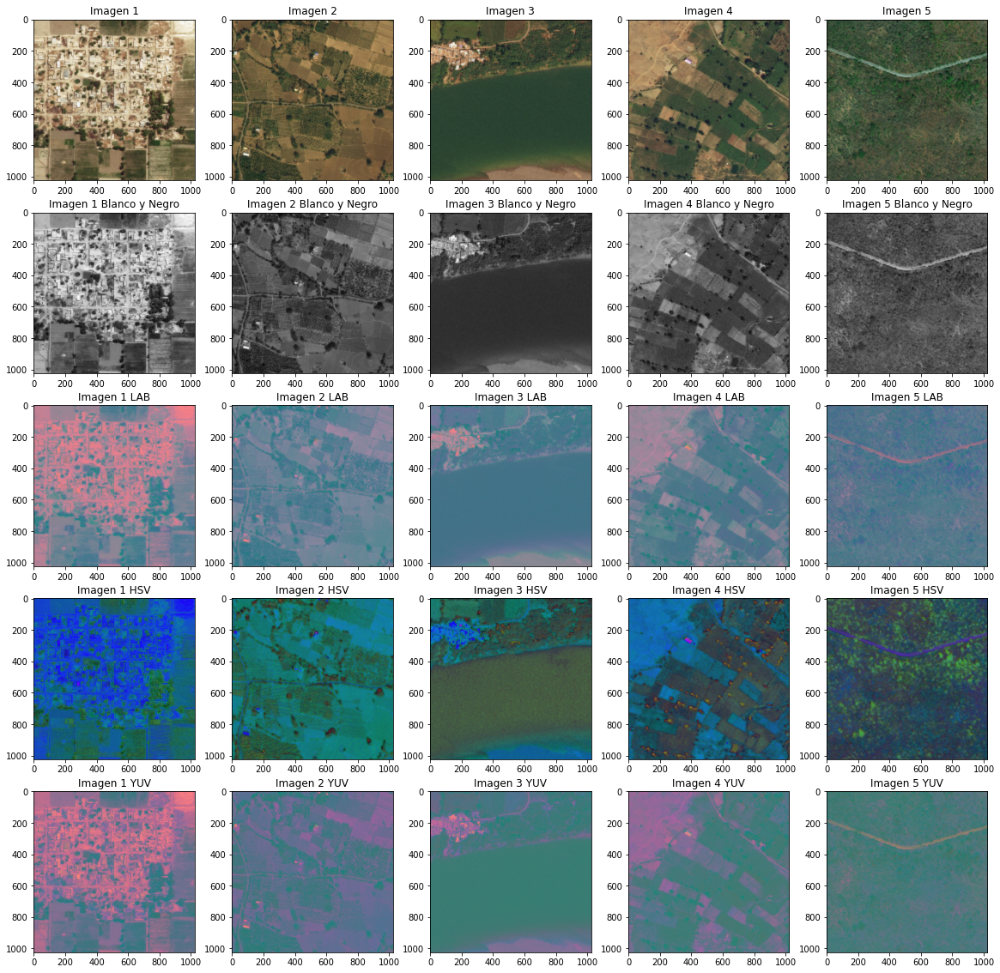

In [7]:
# Imágenes en blanco y negro
img1_bn = img_bn(img1)
img2_bn = img_bn(img2)
img3_bn = img_bn(img3)
img4_bn = img_bn(img4)
img5_bn = img_bn(img5)

# Imágenes en LAB
img1_lab = color_space_convert(img1, "lab")
img2_lab = color_space_convert(img2, "lab")
img3_lab = color_space_convert(img3, "lab")
img4_lab = color_space_convert(img4, "lab")
img5_lab = color_space_convert(img5, "lab")

# Imágenes en HSV
img1_hsv = color_space_convert(img1, "hsv")
img2_hsv = color_space_convert(img2, "hsv")
img3_hsv = color_space_convert(img3, "hsv")
img4_hsv = color_space_convert(img4, "hsv")
img5_hsv = color_space_convert(img5, "hsv")

# Imágenes en YUV
img1_yuv = color_space_convert(img1, "yuv")
img2_yuv = color_space_convert(img2, "yuv")
img3_yuv = color_space_convert(img3, "yuv")
img4_yuv = color_space_convert(img4, "yuv")
img5_yuv = color_space_convert(img5, "yuv")


#Muestra de las imágenes
fig, plots = plt.subplots(5,5 , figsize = (20,20))

# Imágenes originales en espacio de color RGB
plots[0,0].set_title("Imagen 1"), plots[0,0].imshow(img1, cmap="gray")
plots[0,1].set_title("Imagen 2"), plots[0,1].imshow(img2, cmap="gray")
plots[0,2].set_title("Imagen 3"), plots[0,2].imshow(img3, cmap="gray")
plots[0,3].set_title("Imagen 4"), plots[0,3].imshow(img4, cmap="gray")
plots[0,4].set_title("Imagen 5"), plots[0,4].imshow(img5, cmap="gray")

# Blanco y Negro
plots[1,0].set_title("Imagen 1 Blanco y Negro"), plots[1,0].imshow(img1_bn, cmap="gray")
plots[1,1].set_title("Imagen 2 Blanco y Negro"), plots[1,1].imshow(img2_bn, cmap="gray")
plots[1,2].set_title("Imagen 3 Blanco y Negro"), plots[1,2].imshow(img3_bn, cmap="gray")
plots[1,3].set_title("Imagen 4 Blanco y Negro"), plots[1,3].imshow(img4_bn, cmap="gray")
plots[1,4].set_title("Imagen 5 Blanco y Negro"), plots[1,4].imshow(img5_bn, cmap="gray")

# LAB
plots[2,0].set_title("Imagen 1 LAB"), plots[2,0].imshow(img1_lab, cmap="gray")
plots[2,1].set_title("Imagen 2 LAB"), plots[2,1].imshow(img2_lab, cmap="gray")
plots[2,2].set_title("Imagen 3 LAB"), plots[2,2].imshow(img3_lab, cmap="gray")
plots[2,3].set_title("Imagen 4 LAB"), plots[2,3].imshow(img4_lab, cmap="gray")
plots[2,4].set_title("Imagen 5 LAB"), plots[2,4].imshow(img5_lab, cmap="gray")

# HSV
plots[3,0].set_title("Imagen 1 HSV"), plots[3,0].imshow(img1_hsv, cmap="gray")
plots[3,1].set_title("Imagen 2 HSV"), plots[3,1].imshow(img2_hsv, cmap="gray")
plots[3,2].set_title("Imagen 3 HSV"), plots[3,2].imshow(img3_hsv, cmap="gray")
plots[3,3].set_title("Imagen 4 HSV"), plots[3,3].imshow(img4_hsv, cmap="gray")
plots[3,4].set_title("Imagen 5 HSV"), plots[3,4].imshow(img5_hsv, cmap="gray")

# YUV
plots[4,0].set_title("Imagen 1 YUV"), plots[4,0].imshow(img1_yuv, cmap="gray")
plots[4,1].set_title("Imagen 2 YUV"), plots[4,1].imshow(img2_yuv, cmap="gray")
plots[4,2].set_title("Imagen 3 YUV"), plots[4,2].imshow(img3_yuv, cmap="gray")
plots[4,3].set_title("Imagen 4 YUV"), plots[4,3].imshow(img4_yuv, cmap="gray")
plots[4,4].set_title("Imagen 5 YUV"), plots[4,4].imshow(img5_yuv, cmap="gray")

Después de revisar los espacios de color de las imágenes, se concluye que no es de gran utilidad para nuestro problema, esto debido a que el fin del proyecto es mejorar resolución de imágenes, no segmentar o clasificar objetos en estas. 

<h1>
Interpolaciones
</h1>

<hr>

(Text(0.5, 1.0, 'Bicubica 5'), <matplotlib.image.AxesImage at 0x7f51eda61990>)

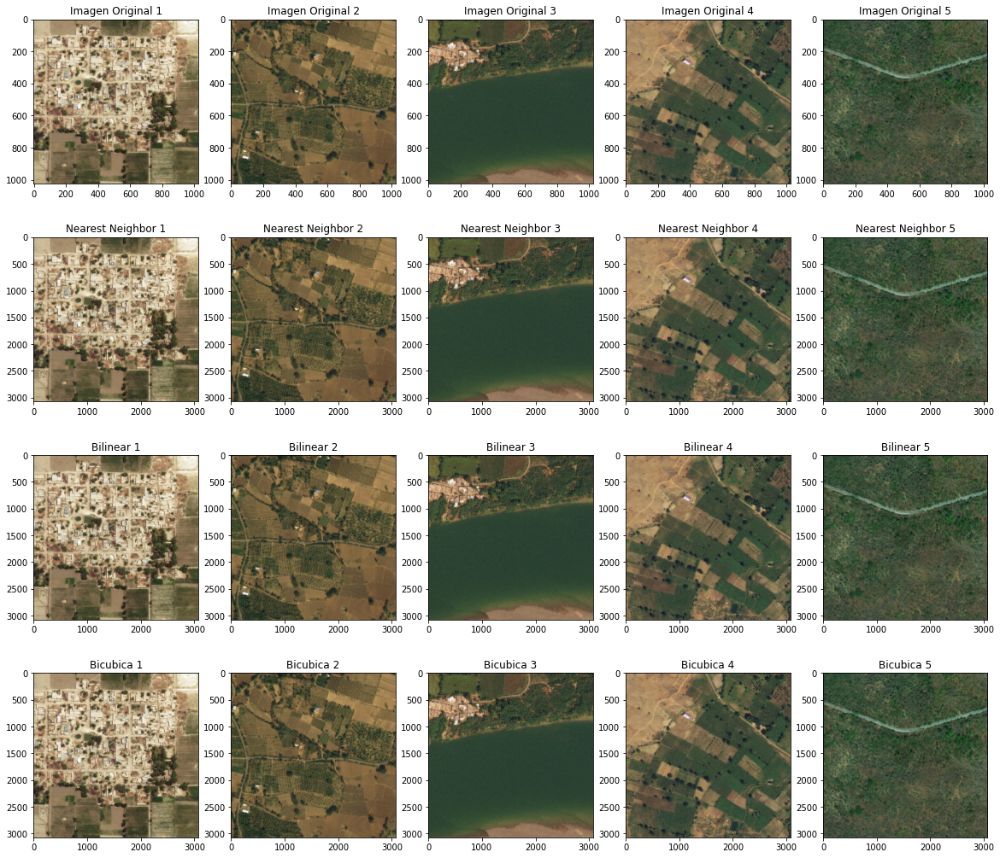

In [8]:
###Nearest Neighbor Interpolation
near_img1 = cv2.resize(img1, None, fx = 3, fy = 3, interpolation = cv2.INTER_NEAREST)
near_img2 = cv2.resize(img2, None, fx = 3, fy = 3, interpolation = cv2.INTER_NEAREST)
near_img3 = cv2.resize(img3, None, fx = 3, fy = 3, interpolation = cv2.INTER_NEAREST)
near_img4 = cv2.resize(img4, None, fx = 3, fy = 3, interpolation = cv2.INTER_NEAREST)
near_img5 = cv2.resize(img5, None, fx = 3, fy = 3, interpolation = cv2.INTER_NEAREST)

###Bilinear Interpolation
bilinear_img1 = cv2.resize(img1,None, fx = 3, fy = 3, interpolation = cv2.INTER_LINEAR)
bilinear_img2 = cv2.resize(img2,None, fx = 3, fy = 3, interpolation = cv2.INTER_LINEAR)
bilinear_img3 = cv2.resize(img3,None, fx = 3, fy = 3, interpolation = cv2.INTER_LINEAR)
bilinear_img4 = cv2.resize(img4,None, fx = 3, fy = 3, interpolation = cv2.INTER_LINEAR)
bilinear_img5 = cv2.resize(img5,None, fx = 3, fy = 3, interpolation = cv2.INTER_LINEAR)

###Bicubic Interpolation
bicubic_img1 = cv2.resize(img1,None, fx = 3, fy = 3, interpolation = cv2.INTER_CUBIC)
bicubic_img2 = cv2.resize(img2,None, fx = 3, fy = 3, interpolation = cv2.INTER_CUBIC)
bicubic_img3 = cv2.resize(img3,None, fx = 3, fy = 3, interpolation = cv2.INTER_CUBIC)
bicubic_img4 = cv2.resize(img4,None, fx = 3, fy = 3, interpolation = cv2.INTER_CUBIC)
bicubic_img5 = cv2.resize(img5,None, fx = 3, fy = 3, interpolation = cv2.INTER_CUBIC)

# Muestra de las imágenes
fig, plots = plt.subplots(4,5 , figsize = (20,18))

# Imágenes Originales
plots[0,0].set_title("Imagen Original 1"), plots[0,0].imshow(img1, cmap="gray")
plots[0,1].set_title("Imagen Original 2"), plots[0,1].imshow(img2, cmap="gray")
plots[0,2].set_title("Imagen Original 3"), plots[0,2].imshow(img3, cmap="gray")
plots[0,3].set_title("Imagen Original 4"), plots[0,3].imshow(img4, cmap="gray")
plots[0,4].set_title("Imagen Original 5"), plots[0,4].imshow(img5, cmap="gray")

# Vecinos cercanos
plots[1,0].set_title("Nearest Neighbor 1"), plots[1,0].imshow(near_img1, cmap="gray")
plots[1,1].set_title("Nearest Neighbor 2"), plots[1,1].imshow(near_img2, cmap="gray")
plots[1,2].set_title("Nearest Neighbor 3"), plots[1,2].imshow(near_img3, cmap="gray")
plots[1,3].set_title("Nearest Neighbor 4"), plots[1,3].imshow(near_img4, cmap="gray")
plots[1,4].set_title("Nearest Neighbor 5"), plots[1,4].imshow(near_img5, cmap="gray")

#Bilinear
plots[2,0].set_title("Bilinear 1"), plots[2,0].imshow(bilinear_img1, cmap="gray")
plots[2,1].set_title("Bilinear 2"), plots[2,1].imshow(bilinear_img2, cmap="gray")
plots[2,2].set_title("Bilinear 3"), plots[2,2].imshow(bilinear_img3, cmap="gray")
plots[2,3].set_title("Bilinear 4"), plots[2,3].imshow(bilinear_img4, cmap="gray")
plots[2,4].set_title("Bilinear 5"), plots[2,4].imshow(bilinear_img5, cmap="gray")

#Bicubica
plots[3,0].set_title("Bicubica 1"), plots[3,0].imshow(bicubic_img1, cmap="gray")
plots[3,1].set_title("Bicubica 2"), plots[3,1].imshow(bicubic_img2, cmap="gray")
plots[3,2].set_title("Bicubica 3"), plots[3,2].imshow(bicubic_img3, cmap="gray")
plots[3,3].set_title("Bicubica 4"), plots[3,3].imshow(bicubic_img4, cmap="gray")
plots[3,4].set_title("Bicubica 5"), plots[3,4].imshow(bicubic_img5, cmap="gray")

Acá se usaron las interpolaciones integradas con OpenCV para aumentar/disminuir el tamaño de la imágen de acuerdo al fx-fy que se elija, pues estos definen el factor.

No se aplicaron métricas ya que no se aprecia diferencias visuales entre la imagen original y la interpolada.

<h1>
Operaciones sobre el histograma
</h1>

<hr>

**Ecualizacion de histograma**


(<matplotlib.image.AxesImage at 0x7f51eb45a890>,
 Text(0.5, 1.0, 'Imagen con histograma ecualizado 5'))

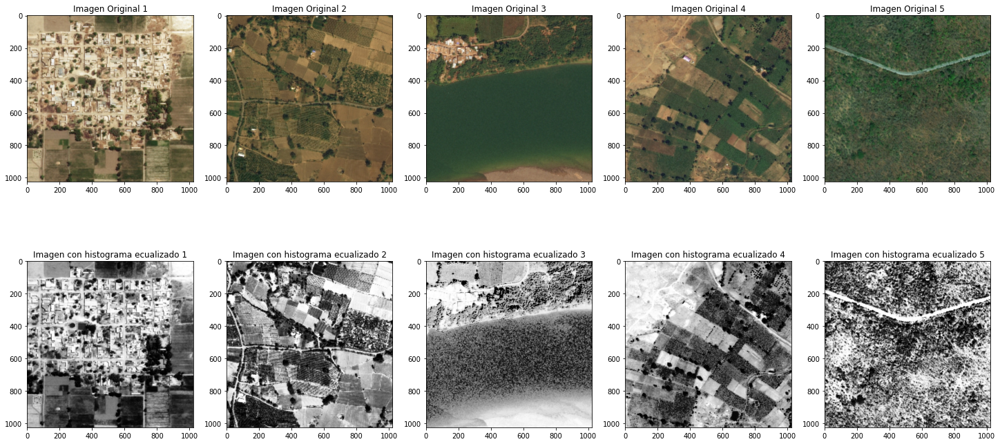

In [9]:
# Calculo de las images ecualizadas para blanco y negro
equalizedImg1 = cv2.equalizeHist(img_bn(img1))
equalizedImg2 = cv2.equalizeHist(img_bn(img2))
equalizedImg3 = cv2.equalizeHist(img_bn(img3))
equalizedImg4 = cv2.equalizeHist(img_bn(img4))
equalizedImg5 = cv2.equalizeHist(img_bn(img5))

# Grafica
fig, arrayPlots = plt.subplots(2, 5, figsize=(25, 12))

# Imagenes Originales
arrayPlots[0, 0].imshow(img1, cmap='gray'), arrayPlots[0, 0].set_title("Imagen Original 1")
arrayPlots[0, 1].imshow(img2, cmap='gray'), arrayPlots[0, 1].set_title("Imagen Original 2")
arrayPlots[0, 2].imshow(img3, cmap='gray'), arrayPlots[0, 2].set_title("Imagen Original 3")
arrayPlots[0, 3].imshow(img4, cmap='gray'), arrayPlots[0, 3].set_title("Imagen Original 4")
arrayPlots[0, 4].imshow(img5, cmap='gray'), arrayPlots[0, 4].set_title("Imagen Original 5")

# Imagenes con el histograma ecualizado
arrayPlots[1, 0].imshow(equalizedImg1, cmap='gray'), arrayPlots[1, 0].set_title("Imagen con histograma ecualizado 1")
arrayPlots[1, 1].imshow(equalizedImg2, cmap='gray'), arrayPlots[1, 1].set_title("Imagen con histograma ecualizado 2")
arrayPlots[1, 2].imshow(equalizedImg3, cmap='gray'), arrayPlots[1, 2].set_title("Imagen con histograma ecualizado 3")
arrayPlots[1, 3].imshow(equalizedImg4, cmap='gray'), arrayPlots[1, 3].set_title("Imagen con histograma ecualizado 4")
arrayPlots[1, 4].imshow(equalizedImg5, cmap='gray'), arrayPlots[1, 4].set_title("Imagen con histograma ecualizado 5")

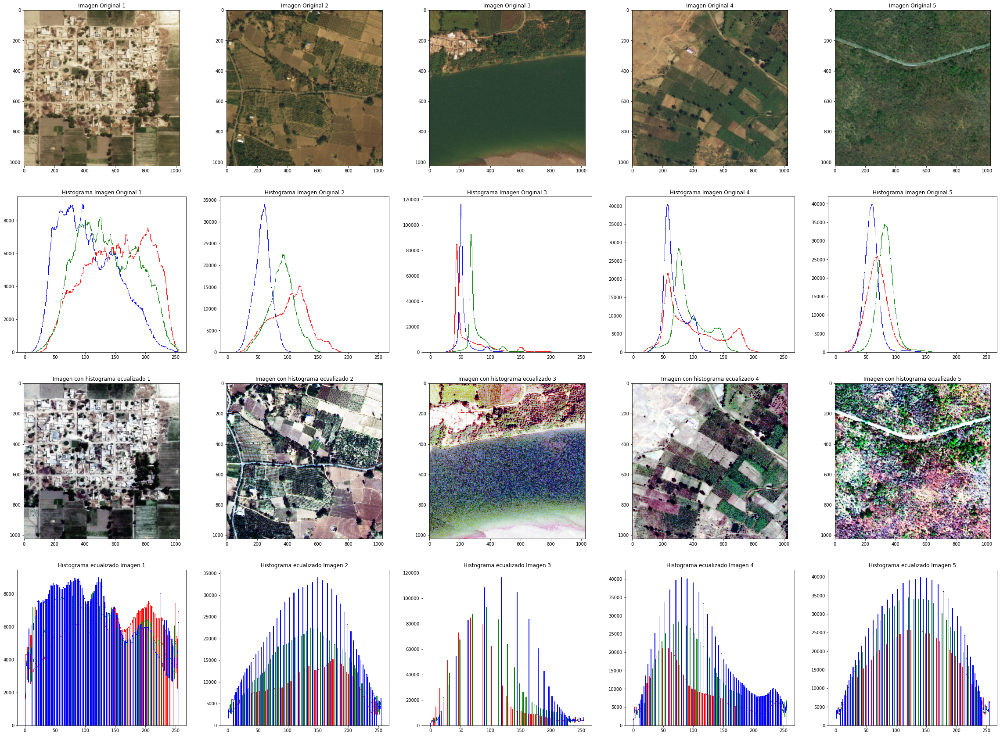

In [10]:
# Aplicar la función equalizeHist de OpenCV para realizar la ecualización en todos los canales de RGB
res1 = apply_f_on_rgb(img1, cv2.equalizeHist, [])
res2 = apply_f_on_rgb(img2, cv2.equalizeHist, [])
res3 = apply_f_on_rgb(img3, cv2.equalizeHist, [])
res4 = apply_f_on_rgb(img4, cv2.equalizeHist, [])
res5 = apply_f_on_rgb(img5, cv2.equalizeHist, [])

# Mostrar la comparativa de los histogramas originales y los ecualizados
fig, plots = plt.subplots(4,5 , figsize = (40,30))

colors = ['Red', 'Green', 'Blue']

# Imagen Original
plots[0,0].set_title("Imagen Original 1"), plots[0,0].imshow(img1, cmap="gray")
plots[0,1].set_title("Imagen Original 2"), plots[0,1].imshow(img2, cmap="gray")
plots[0,2].set_title("Imagen Original 3"), plots[0,2].imshow(img3, cmap="gray")
plots[0,3].set_title("Imagen Original 4"), plots[0,3].imshow(img4, cmap="gray")
plots[0,4].set_title("Imagen Original 5"), plots[0,4].imshow(img5, cmap="gray")

# Histograma de las imágenes originales
plots[1,0].set_title("Histograma Imagen Original 1")
for i,col in enumerate(colors):
    img_array_i = img1[:,:,i].ravel()
    plots[1,0].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,1].set_title("Histograma Imagen Original 2")
for i,col in enumerate(colors):
    img_array_i = img2[:,:,i].ravel()
    plots[1,1].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,2].set_title("Histograma Imagen Original 3")
for i,col in enumerate(colors):
    img_array_i = img3[:,:,i].ravel()
    plots[1,2].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,3].set_title("Histograma Imagen Original 4"),
for i,col in enumerate(colors):
    img_array_i = img4[:,:,i].ravel()
    plots[1,3].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,4].set_title("Histograma Imagen Original 5")
for i,col in enumerate(colors):
    img_array_i = img5[:,:,i].ravel()
    plots[1,4].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])

# Ecualización
plots[2,0].set_title("Imagen con histograma ecualizado 1"), plots[2,0].imshow(res1, cmap="gray")
plots[2,1].set_title("Imagen con histograma ecualizado 2"), plots[2,1].imshow(res2, cmap="gray")
plots[2,2].set_title("Imagen con histograma ecualizado 3"), plots[2,2].imshow(res3, cmap="gray")
plots[2,3].set_title("Imagen con histograma ecualizado 4"), plots[2,3].imshow(res4, cmap="gray")
plots[2,4].set_title("Imagen con histograma ecualizado 5"), plots[2,4].imshow(res5, cmap="gray")

# Histograma Ecualizado
plots[3,0].set_title("Histograma ecualizado Imagen 1")
for i,col in enumerate(colors):
    img_array_i = res1[:,:,i].ravel()
    plots[3,0].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,1].set_title("Histograma ecualizado Imagen 2")
for i,col in enumerate(colors):
    img_array_i = res2[:,:,i].ravel()
    plots[3,1].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,2].set_title("Histograma ecualizado Imagen 3")
for i,col in enumerate(colors):
    img_array_i = res3[:,:,i].ravel()
    plots[3,2].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,3].set_title("Histograma ecualizado Imagen 4"),
for i,col in enumerate(colors):
    img_array_i = res4[:,:,i].ravel()
    plots[3,3].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,4].set_title("Histograma ecualizado Imagen 5")
for i,col in enumerate(colors):
    img_array_i = res5[:,:,i].ravel()
    plots[3,4].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])

En este caso, estas ecualizaciones no nos ayudan mucho, pues las imágenes no obtienen ningún beneficio visible del proceso realizado, por lo tanto, se descarta su uso.

**Mejorando la resolución en imágenes satelitales mediante la ecualización del histograma**



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.


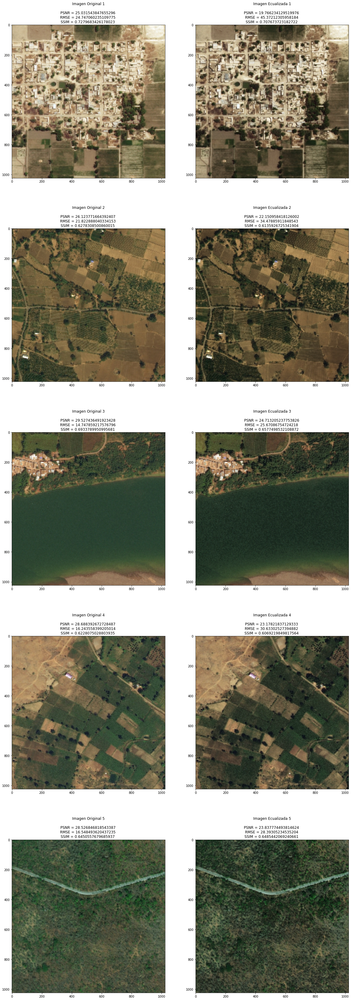

In [11]:
# Se hace uso de la función addWeighted de openCV, la cual brinda un método para sumar las imágenes aplicando transparencia

fig, arrayPlots = plt.subplots(5, 2, figsize=(20, 60))

c = equalizedImage(img1)
img_eq_1 =cv2.addWeighted(img1, 0.6, c, 0.4, 0)
arrayPlots[0,0].set_title("Imagen Original 1\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img1,img1_hd)[0]), str(compare_images(img1,img1_hd)[1]), str(compare_images(img1,img1_hd)[2])))
arrayPlots[0,0].imshow(img1)
arrayPlots[0,1].set_title("Imagen Ecualizada 1\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img_eq_1,img1_hd)[0]), str(compare_images(img_eq_1,img1_hd)[1]), str(compare_images(img_eq_1,img1_hd)[2])))
arrayPlots[0,1].imshow(img_eq_1)

c = equalizedImage(img2)
img_eq_2 =cv2.addWeighted(img2, 0.6, c, 0.4, 0)
arrayPlots[1,0].set_title("Imagen Original 2\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img2,img2_hd)[0]), str(compare_images(img2,img2_hd)[1]), str(compare_images(img2,img2_hd)[2])))
arrayPlots[1,0].imshow(img2)
arrayPlots[1,1].set_title("Imagen Ecualizada 2\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img_eq_2,img2_hd)[0]), str(compare_images(img_eq_2,img2_hd)[1]), str(compare_images(img_eq_2,img2_hd)[2])))
arrayPlots[1,1].imshow(img_eq_2)

c = equalizedImage(img3)
img_eq_3 =cv2.addWeighted(img3, 0.6, c, 0.4, 0)
arrayPlots[2,0].set_title("Imagen Original 3\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img3,img3_hd)[0]), str(compare_images(img3,img3_hd)[1]), str(compare_images(img3,img3_hd)[2])))
arrayPlots[2,0].imshow(img3)
arrayPlots[2,1].set_title("Imagen Ecualizada 3\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img_eq_3,img3_hd)[0]), str(compare_images(img_eq_3,img3_hd)[1]), str(compare_images(img_eq_3,img3_hd)[2])))
arrayPlots[2,1].imshow(img_eq_3)

c = equalizedImage(img4)
img_eq_4 =cv2.addWeighted(img4, 0.6, c, 0.4, 0)
arrayPlots[3,0].set_title("Imagen Original 4\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img4,img4_hd)[0]), str(compare_images(img4,img4_hd)[1]), str(compare_images(img4,img4_hd)[2])))
arrayPlots[3,0].imshow(img4)
arrayPlots[3,1].set_title("Imagen Ecualizada 4\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img_eq_4,img4_hd)[0]), str(compare_images(img_eq_4,img4_hd)[1]), str(compare_images(img_eq_4,img4_hd)[2])))
arrayPlots[3,1].imshow(img_eq_4)

c = equalizedImage(img5)
img_eq_5 =cv2.addWeighted(img5, 0.6, c, 0.4, 0)
arrayPlots[4,0].set_title("Imagen Original 5\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img5,img5_hd)[0]), str(compare_images(img5,img5_hd)[1]), str(compare_images(img5,img5_hd)[2])))
arrayPlots[4,0].imshow(img5)
arrayPlots[4,1].set_title("Imagen Ecualizada 5\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img_eq_5,img5_hd)[0]), str(compare_images(img_eq_5,img5_hd)[1]), str(compare_images(img_eq_5,img5_hd)[2])))
arrayPlots[4,1].imshow(img_eq_5)

En estas imágenes se analiza la suma entre la imágen original y la imagen con ecualización del histograma, a simple vista se nota una mejora en los colores para las imágenes resultantes de esta suma. El problema radica al comparar con las métricas, pues se observa que peores medidas en la imágen ecualizada que en la original, sin embargo, se comprueba que este método visualmente mejora la resolución en las imágenes satelitales.

##**Corrección Gamma**

(Text(0.5, 1.0, 'Gamma 1/2 Imagen 5'),
 <matplotlib.image.AxesImage at 0x7f51ea3aaa90>)

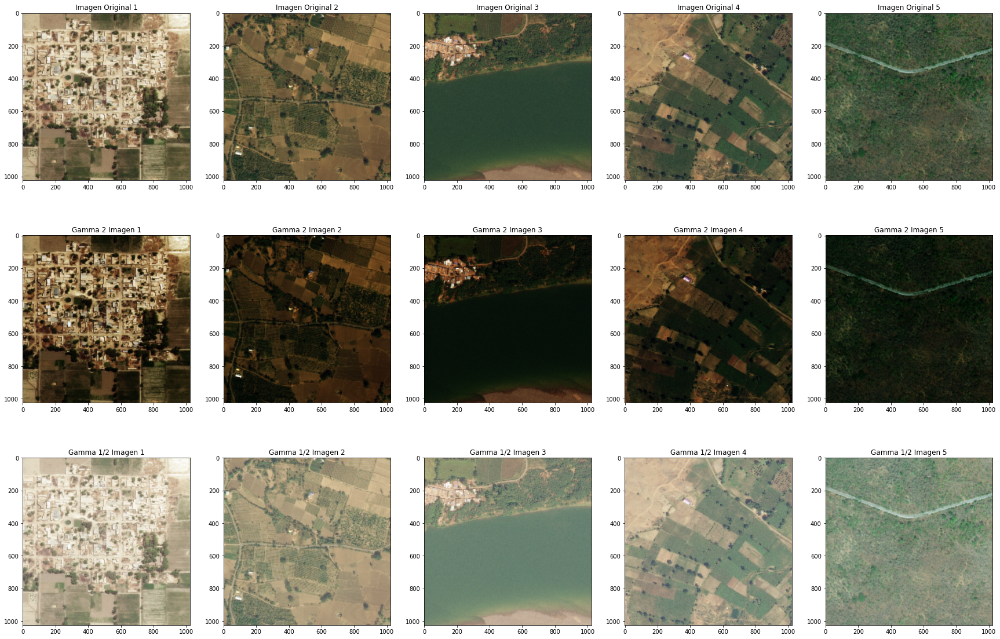

In [12]:
a = 1
gamma1 = 2
gamma2 = 0.5

# Se muestran diferentes valores de gamma aplicados a cada una a las 5 imágenes.
res1_img1 = apply_f_on_rgb(img1, gamma_correction, [a, gamma1])
res2_img1 = apply_f_on_rgb(img1, gamma_correction, [a, gamma2])

res1_img2 = apply_f_on_rgb(img2, gamma_correction, [a, gamma1])
res2_img2 = apply_f_on_rgb(img2, gamma_correction, [a, gamma2])

res1_img3 = apply_f_on_rgb(img3, gamma_correction, [a, gamma1])
res2_img3 = apply_f_on_rgb(img3, gamma_correction, [a, gamma2])

res1_img4 = apply_f_on_rgb(img4, gamma_correction, [a, gamma1])
res2_img4 = apply_f_on_rgb(img4, gamma_correction, [a, gamma2])

res1_img5 = apply_f_on_rgb(img5, gamma_correction, [a, gamma1])
res2_img5 = apply_f_on_rgb(img5, gamma_correction, [a, gamma2])



#Mostramos las imágenes
fig, plots = plt.subplots(3,5 , figsize = (30,20))

#Color
plots[0,0].set_title("Imagen Original 1"), plots[0,0].imshow(img1, cmap="gray")
plots[0,1].set_title("Imagen Original 2"), plots[0,1].imshow(img2, cmap="gray")
plots[0,2].set_title("Imagen Original 3"), plots[0,2].imshow(img3, cmap="gray")
plots[0,3].set_title("Imagen Original 4"), plots[0,3].imshow(img4, cmap="gray")
plots[0,4].set_title("Imagen Original 5"), plots[0,4].imshow(img5, cmap="gray")

#Gamma
plots[1,0].set_title("Gamma 2 Imagen 1"), plots[1,0].imshow(res1_img1, cmap="gray")
plots[1,1].set_title("Gamma 2 Imagen 2"), plots[1,1].imshow(res1_img2, cmap="gray")
plots[1,2].set_title("Gamma 2 Imagen 3"), plots[1,2].imshow(res1_img3, cmap="gray")
plots[1,3].set_title("Gamma 2 Imagen 4"), plots[1,3].imshow(res1_img4, cmap="gray")
plots[1,4].set_title("Gamma 2 Imagen 5"), plots[1,4].imshow(res1_img5, cmap="gray")

plots[2,0].set_title("Gamma 1/2 Imagen 1"), plots[2,0].imshow(res2_img1, cmap="gray")
plots[2,1].set_title("Gamma 1/2 Imagen 2"), plots[2,1].imshow(res2_img2, cmap="gray")
plots[2,2].set_title("Gamma 1/2 Imagen 3"), plots[2,2].imshow(res2_img3, cmap="gray")
plots[2,3].set_title("Gamma 1/2 Imagen 4"), plots[2,3].imshow(res2_img4, cmap="gray")
plots[2,4].set_title("Gamma 1/2 Imagen 5"), plots[2,4].imshow(res2_img5, cmap="gray")



De acuerdo con las imágenes observadas anteriormente, la corrección gamma se usa para aumentar o disminuir el brillo en las imágenes de acuerdo a la necesidad del momento. Para el mejoramiento visual de la resolución no se muestra como una técnica viable

##**Expansión del histograma**

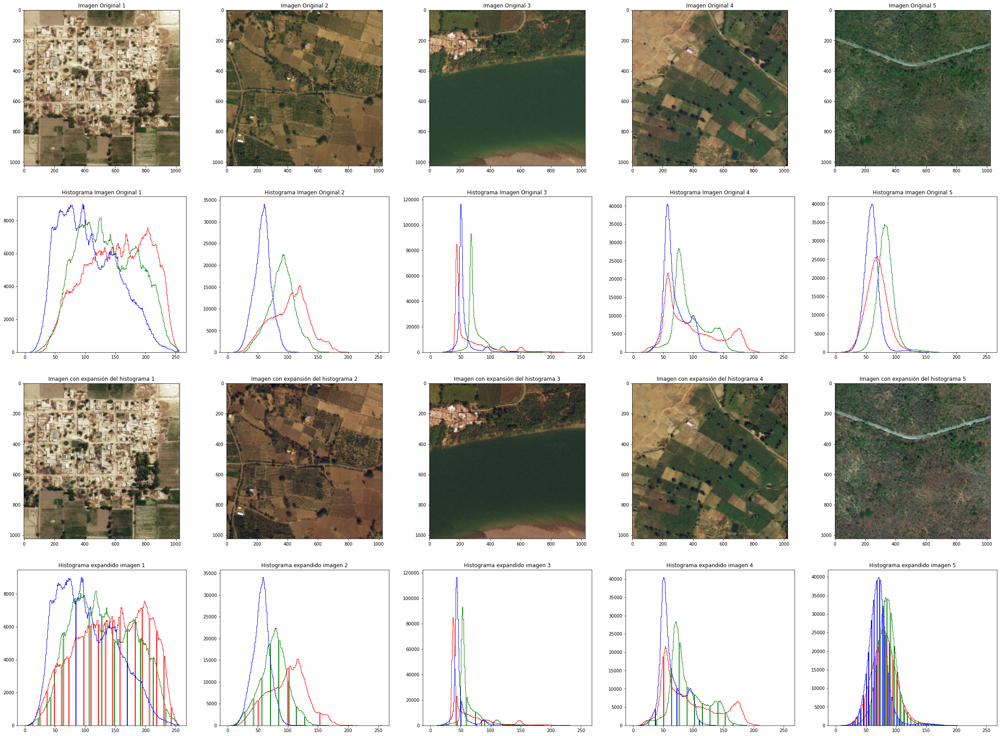

In [13]:
# Aplicar la transformación expansión de histograma sobre la imagen de entrada
res1 = apply_f_on_rgb(img1, histogram_expansion, [])
res2 = apply_f_on_rgb(img2, histogram_expansion, [])
res3 = apply_f_on_rgb(img3, histogram_expansion, [])
res4 = apply_f_on_rgb(img4, histogram_expansion, [])
res5 = apply_f_on_rgb(img5, histogram_expansion, [])


# Se muestran las imágenes junto a sus histogramas (tanto original como el expandido)
fig, plots = plt.subplots(4,5 , figsize = (40,30))

# Imagen Original
plots[0,0].set_title("Imagen Original 1"), plots[0,0].imshow(img1, cmap="gray")
plots[0,1].set_title("Imagen Original 2"), plots[0,1].imshow(img2, cmap="gray")
plots[0,2].set_title("Imagen Original 3"), plots[0,2].imshow(img3, cmap="gray")
plots[0,3].set_title("Imagen Original 4"), plots[0,3].imshow(img4, cmap="gray")
plots[0,4].set_title("Imagen Original 5"), plots[0,4].imshow(img5, cmap="gray")

# Histograma normal
colors = ("r","g","b")

plots[1,0].set_title("Histograma Imagen Original 1")
for i,col in enumerate(colors):
    img_array_i = img1[:,:,i].ravel()
    plots[1,0].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,1].set_title("Histograma Imagen Original 2")
for i,col in enumerate(colors):
    img_array_i = img2[:,:,i].ravel()
    plots[1,1].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,2].set_title("Histograma Imagen Original 3")
for i,col in enumerate(colors):
    img_array_i = img3[:,:,i].ravel()
    plots[1,2].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,3].set_title("Histograma Imagen Original 4"),
for i,col in enumerate(colors):
    img_array_i = img4[:,:,i].ravel()
    plots[1,3].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[1,4].set_title("Histograma Imagen Original 5")
for i,col in enumerate(colors):
    img_array_i = img5[:,:,i].ravel()
    plots[1,4].hist(img_array_i,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])

# Expansion
plots[2,0].set_title("Imagen con expansión del histograma 1"), plots[2,0].imshow(res1, cmap="gray")
plots[2,1].set_title("Imagen con expansión del histograma 2"), plots[2,1].imshow(res2, cmap="gray")
plots[2,2].set_title("Imagen con expansión del histograma 3"), plots[2,2].imshow(res3, cmap="gray")
plots[2,3].set_title("Imagen con expansión del histograma 4"), plots[2,3].imshow(res4, cmap="gray")
plots[2,4].set_title("Imagen con expansión del histograma 5"), plots[2,4].imshow(res5, cmap="gray")

# Histograma Expandido
plots[3,0].set_title("Histograma expandido imagen 1")
for i,col in enumerate(colors):
    img_array_j = res1[:,:,i].ravel()
    plots[3,0].hist(img_array_j,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,1].set_title("Histograma expandido imagen 2")
for i,col in enumerate(colors):
    img_array_j = res2[:,:,i].ravel()
    plots[3,1].hist(img_array_j,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,2].set_title("Histograma expandido imagen 3")
for i,col in enumerate(colors):
    img_array_j = res3[:,:,i].ravel()
    plots[3,2].hist(img_array_j,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,3].set_title("Histograma expandido imagen 4"),
for i,col in enumerate(colors):
    img_array_j = res4[:,:,i].ravel()
    plots[3,3].hist(img_array_j,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])
    
plots[3,4].set_title("Histograma expandido imagen 5")
for i,col in enumerate(colors):
    img_array_j = res5[:,:,i].ravel()
    plots[3,4].hist(img_array_j,histtype='step', bins=255, 
                            range=(0.0, 255.0), color=colors[i])


Se procede a realizar 3 operaciones y analizar el respectivo histograma con la distribución acumulada de pixeles:
- **reescalamiento de intensidad**
- **ecualización del histograma** 
- **ecualización adaptativa**.

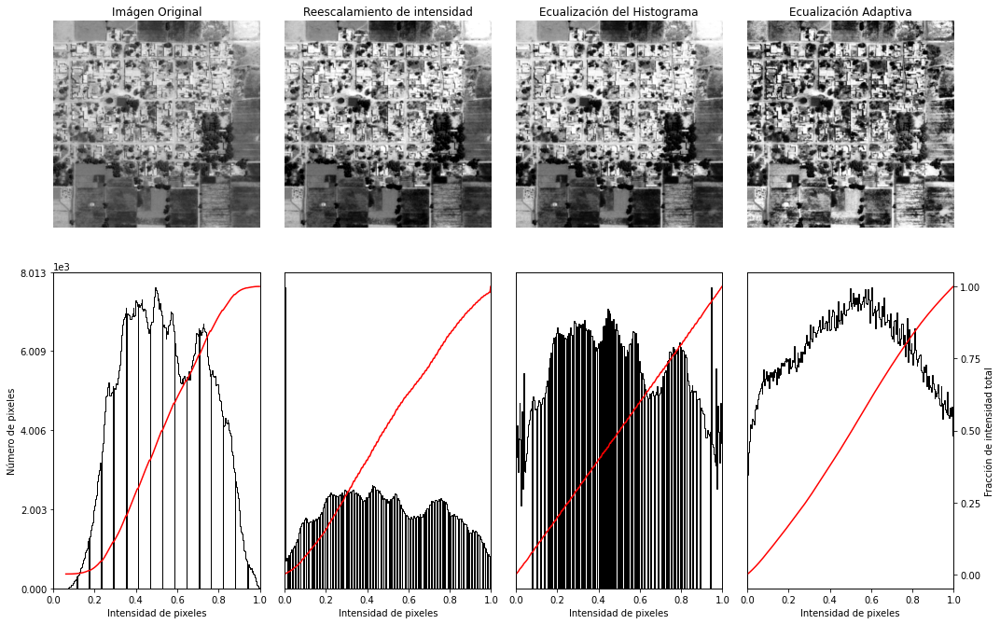

In [14]:
from skimage import io
from skimage import exposure
from skimage import data, img_as_float

img = cv2.cvtColor(img1, cv2.COLOR_RGB2GRAY)

# reescalar la intensidad de contraste
p2, p98 = np.percentile(img, (2, 98))
img_rescale = exposure.rescale_intensity(img, in_range=(p2, p98))

# Ecualización
img_eq = exposure.equalize_hist(img)

# Ecualización adaptativa
img_adapteq = exposure.equalize_adapthist(img, clip_limit=0.03)

# Mostrar las gráficas y su respectivo histograma
fig = plt.figure(figsize=(15, 10))
axes = np.zeros((2, 4), dtype=np.object)
axes[0, 0] = fig.add_subplot(2, 4, 1)
for i in range(1, 4):
    axes[0, i] = fig.add_subplot(2, 4, 1+i, sharex=axes[0,0], sharey=axes[0,0])
for i in range(0, 4):
    axes[1, i] = fig.add_subplot(2, 4, 5+i)

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img, axes[:, 0])
ax_img.set_title('Imágen Original')

y_min, y_max = ax_hist.get_ylim()
ax_hist.set_ylabel('Número de pixeles')
ax_hist.set_yticks(np.linspace(0, y_max, 5))

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_rescale, axes[:, 1])
ax_img.set_title('Reescalamiento de intensidad')

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_eq, axes[:, 2])
ax_img.set_title('Ecualización del Histograma')

ax_img, ax_hist, ax_cdf = plot_img_and_hist(img_adapteq, axes[:, 3])
ax_img.set_title('Ecualización Adaptiva')

ax_cdf.set_ylabel('Fracción de intensidad total')
ax_cdf.set_yticks(np.linspace(0, 1, 5))

# darle formato a la figura
fig.tight_layout()
plt.show()

La **ecualización adaptativa** se presenta cómo una posible alternativa para mejorar la resolución, por esta razón tanteamos con estos algoritmos para ver cual presenta mejores resultados en aumentar la resolución de las imágenes.

<h1>
Ecualización Adaptativa de Histograma mediante Contraste Limitado (CLAHE):
</h1>

<hr>


Es una variante de la ecualización adaptativa de histograma (AHE) que se encarga de la sobreamplificación del contraste. CLAHE opera en pequeñas regiones de la imagen, llamadas mosaicos, en lugar de en la imagen completa. A continuación, los mosaicos vecinos se combinan mediante interpolación bilineal para eliminar los límites artificiales.
Este algoritmo se puede aplicar para mejorar el contraste de las imágenes.

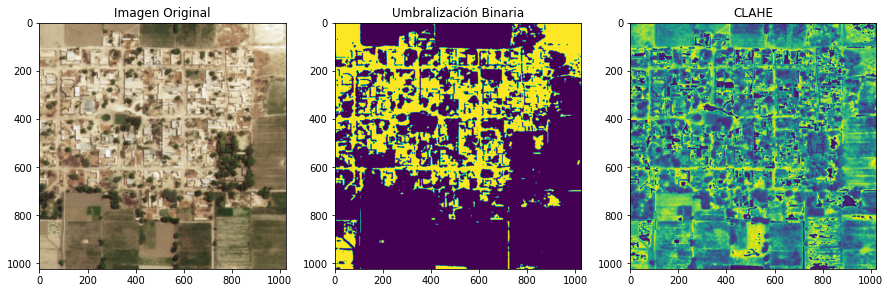

In [15]:
# Umbralización

# se aplica un filtro Blur de mediana y pasamos a escala de grises
img = cv2.medianBlur(img1, 3) 
image_bw = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 

# Umbralización ordinaria de la imágen (mediante binary)
_, ord_tresh_img = cv2.threshold(image_bw, 155, 255, cv2.THRESH_BINARY) 

# declaración de CLAHE  
# clipLimit -> coeficiente de Umbralización por contraste limitado
clahe = cv2.createCLAHE(clipLimit = 5) 
clahe_img = clahe.apply(image_bw) + 30


display = [img, ord_tresh_img, clahe_img]
label = ["Imagen Original", "Umbralización Binaria", "CLAHE"]

fig = plt.figure(figsize=(15, 15))
for i in range(len(display)):

		fig.add_subplot(2, 3, i+1)
		plt.imshow(display[i])
		plt.title(label[i])

plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.


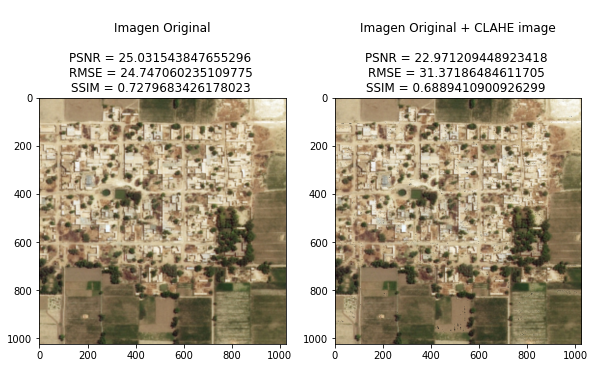

In [16]:
# juntando la imágen original con clahe
final_img = cv2.bitwise_and(img1, img1, mask=clahe_img)

display = [img, final_img]
label = ['\nImagen Original\n'+ '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img1,img1_hd)[0]), str(compare_images(img1,img1_hd)[1]), str(compare_images(img1,img1_hd)[2])), 
         '\nImagen Original + CLAHE image\n' + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(final_img,img1_hd)[0]), str(compare_images(final_img,img1_hd)[1]), str(compare_images(final_img,img1_hd)[2]))]

fig = plt.figure(figsize=(15, 15))
for i in range(len(display)):

		fig.add_subplot(2, 3, i+1)
		plt.imshow(display[i])
		plt.title(label[i])

plt.show()

La primera intuición al analizar el histograma para la ecualización adaptativa indica una posible solución para el problema de mejorar la resolución, con este algoritmo se observa una mejor calidad en la imágen, sin embargo se resaltan algunas regiones y patrones que no están tan marcados en una imagen en alta definición, por esta razón se descarta como técnica totalmente confiable para la solución de este problema.

<h1>
Algoritmos de agrupamiento
</h1>

<hr>

El clustering es una de las herramientas más utilizadas para ver segmentaciones de los datos y tener una intuición de cómo están estructurados los mismos.

Esta técnica no supervisada se basa en identificar grupos en los datos de tal manera que todos los datos del grupo (clúster) son datos con características similares mientras que los datos de los otros grupos son diferentes.

- **Algoritmo K-Means**: El objetivo de este algoritmo es agrupar observaciones similares para descubrir patrones que a simple vista se desconocen. Para conseguirlo, el algoritmo busca un número fijo (k) de clústers en el dataset.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: UserWarning: DEPRECATED: skimage.measure.compare_ssim has been moved to skimage.metrics.structural_similarity. It will be removed from skimage.measure in version 0.18.


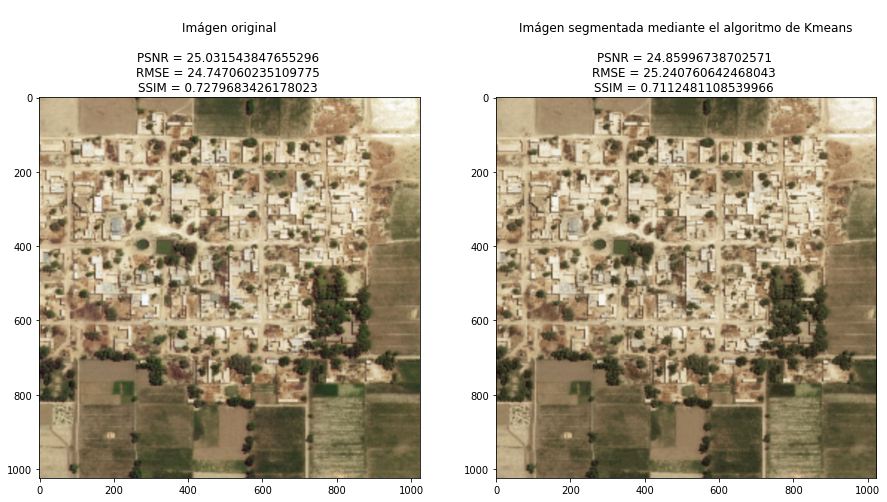

In [17]:
# Cargar la imagen de entrada.
#img = cv2.imread(os.path.join(file_path, "5.jpeg"), cv2.IMREAD_COLOR)
#img = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
filtered_img = np.copy(img1)

# Aplanar la imagen convirtiendola en un vector de puntos
pixel_values = filtered_img.reshape((-1,3))
pixel_values = np.float32(pixel_values)

# Criterio de paro para el algoritmo. Terminaremos cuando la última actualización de los centroides sea menor a
# *epsilon* (cv2.TERM_CRITERIA_EPS), donde epsilon es 1.0 (último elemento de la tupla), o cuando se hayan completado
#  10 iteraciones (segundo elemento de la tupla, criterio cv2.TERM_CRITERIA_MAX_ITER).
stop_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

# Número de veces que se correrá K-Means con diferentes inicializaciones. La función retornará los mejores resultados.
number_of_attempts = 1

# Inicializar los centroides. Usamos una inicialización aleatoria.
centroid_initialization_strategy = cv2.KMEANS_RANDOM_CENTERS
K = 300

# Ejecutamos K-Means

# El algoritmo retorna las siguientes salidas:
# - Un arreglo con la distancia de cada punto a su centroide. Aquí lo ignoramos.
# - Arreglo de etiquetas.
# - Arreglo de centroides.
_, labels, centers = cv2.kmeans(pixel_values,                         # - El arreglo de pixeles.
                                K,                                    # - K = número de clusters a hallar.
                                None,                                 # - None indicando que no pasaremos un arreglo opcional con las mejores etiquetas.
                                stop_criteria,                        # - Condición de parada.
                                number_of_attempts,                   # - Número de ejecuciones.
                                centroid_initialization_strategy)     # - Estrategia de inicialización.

# Aplicamos las etiquetas a los centroides para segmentar los pixeles en su grupo correspondiente.
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]

# Se debe reestructurar el arreglo de datos segmentados con las dimensiones de la imagen original.
segmented_img = segmented_data.reshape(filtered_img.shape)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))

ax1.set_title("\nImágen original\n"+ '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(img1,img1_hd)[0]), str(compare_images(img1,img1_hd)[1]), str(compare_images(img1,img1_hd)[2])))
ax1.imshow(img1)

ax2.set_title("\nImágen segmentada mediante el algoritmo de Kmeans\n" + '\nPSNR = {} \nRMSE = {} \nSSIM = {} '.format(str(compare_images(segmented_img,img1_hd)[0]), str(compare_images(segmented_img,img1_hd)[1]), str(compare_images(segmented_img,img1_hd)[2])))
ax2.imshow(segmented_img)


El algoritmo de **k-means** es ampliamente utilizado en tareas de agrupación y segmentación en general, se tantea aplicandolo en nuestro problema de superresolución con una cantidad ingresada de 300 clusters, exploramos este algoritmo como una alternativa de solución, sin embargo los resultados en las métricas no son los esperados.

<h1>
Conclusión:
</h1>

<hr>
Estás técnicas presentadas en el notebook demuestran que el tema de Super-resolución es problema difícil de tratar con enfoques de visión clásica y de Machine Learning tradicional, por esta razón se hace necesario aplicar técnicas de reconocimiento de patrones más complejas, más costosas computacionalmente y por tanto, menos interpretables, cómo lo son los algoritmos bioinspirados y en particular las redes neuronales.